# Unit 5 - Financial Planning


In [43]:
# Initial imports
import os
import requests
import pandas as pd

from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation
import json

%matplotlib inline

In [44]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [45]:
print("Monash Uni - Fintech Bootcamp Feb 2021 - Sreeni Kalva's Submission")


# Set current amount of crypto assets
my_btc = 1.2
my_eth = 5.3

Monash Uni - Fintech Bootcamp Feb 2021 - Sreeni Kalva's Submission


In [46]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/"

In [47]:
# Fetch current BTC price
response_data_btc = requests.get(btc_url)
#response_data_btc.content 
text_data = response_data_btc.text
#type(text_data)
parsed = json.loads(text_data)
#print(json.dumps(parsed, indent=4))
btc_price = parsed["data"]["1"]["quotes"]["USD"]["price"]
#print(btc_price)
#type(btc_price)
my_btc_value = my_btc * btc_price

# Fetch current ETH price
response_data_eth = requests.get(eth_url)
#response_data_btc.content
text_data = response_data_eth.text
#type(text_data)
parsed = json.loads(text_data)
#print(json.dumps(parsed, indent=4))
eth_price = parsed["data"]["1027"]["quotes"]["USD"]["price"]
#print(eth_price)
#type(eth_price)
my_eth_value = my_eth * eth_price

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${my_btc_value:0.2f} USD")
print(f"The current value of your {my_eth} ETH is ${my_eth_value:0.2f} USD")

The current value of your 1.2 BTC is $66565.20 USD
The current value of your 5.3 ETH is $9013.92 USD


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [48]:
# Set the tickers
tickers = ["SPY", "AGG"]

# Set current amount of shares data
shares_data = {
    "shares": [50, 200]
}

# Create the shares DataFrame
df_shares = pd.DataFrame(shares_data, index=tickers)

# Display shares data
df_shares

,shares
SPY,50
AGG,200


In [49]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

# Verify that Alpaca key and secret were correctly loaded
#print(f"Alpaca Key type: {(alpaca_api_key)}")
#print(f"Alpaca Secret Key type: {(alpaca_secret_key)}")

In [50]:
# Format current date as ISO format
today = pd.Timestamp("2021-03-19", tz="America/New_York").isoformat()

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

df_portfolio = alpaca.get_barset(
    tickers,
    timeframe,
    start = today,
    end = today
).df

# Preview DataFrame
df_portfolio.head(5)

# Get current closing prices for SPY and AGG
spy_close_price = float(df_portfolio["SPY"]["close"])
agg_close_price = float(df_portfolio["AGG"]["close"])

In [51]:
# Pick AGG and SPY close prices
# YOUR CODE HERE!

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")

Current AGG closing price: $113.5
Current SPY closing price: $389.5


In [52]:
# Compute the current value of shares
spa_shares = df_shares.loc["SPY"]["shares"]
agg_shares = df_shares.loc["AGG"]["shares"]
my_spy_value = spy_close_price * df_shares.loc["SPY"]["shares"]
my_agg_value = agg_close_price * df_shares.loc["AGG"]["shares"]

# Print current value of share
print(f"The current value of your {spa_shares} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {agg_shares} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $19475.00
The current value of your 200 AGG shares is $22700.00


### Savings Health Analysis

In [53]:
# Set monthly household income
monthly_income = 12000
crypto_amount = my_btc_value + my_eth_value
shares_amount = my_spy_value + my_agg_value

# Create savings DataFrame
# Set current amount of shares data
savings_data = {
    "amounts": [crypto_amount,shares_amount]
}

# Set the tickers
savings = ["crypto", "shares"]

# Create the shares DataFrame
df_savings = pd.DataFrame(savings_data, index=savings)

# Display shares data
df_savings

# Display savings DataFrame
display(df_savings)

,amounts
crypto,75579.122
shares,42175.000


<AxesSubplot:title={'center':'Savings Amount Composition'}, ylabel='amounts'>

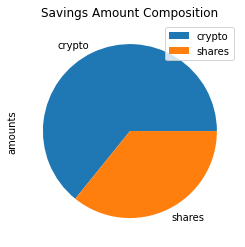

In [54]:
# Plot savings pie chart
df_savings.plot.pie(y="amounts", title="Savings Amount Composition")


In [55]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3

# Calculate total amount of savings
total_savings_amount = crypto_amount + shares_amount
print(f"Emergency fund need:{emergency_fund} // Savings in Assets:{total_savings_amount}")
print(f"Running Savings Analysis...")

# Validate saving health
if total_savings_amount > emergency_fund:
    print("Congratulations for having enough money in the emergency fund!!!")
elif total_savings_amount > emergency_fund:
    print("Congratulations on reaching the goalin the emergency fund!")
else: 
    print(f"You are short of {emergency_fund - total_savings_amount} from reaching yor emergency fund goal. Keep saving..")

Emergency fund need:36000 // Savings in Assets:117754.122
Running Savings Analysis...
Congratulations for having enough money in the emergency fund!!!


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [56]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2016-03-19', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2021-03-20', tz='America/New_York').isoformat()

In [57]:
# Get 5 years' worth of historical data for SPY and AGG

df_ticker = alpaca.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date,
    limit=1000
).df

# Display sample data
df_ticker.head()

AGG                                         SPY  \
                             open    high     low   close     volume     open   
time                                                                            
2017-03-29 00:00:00-04:00  108.48  108.62  108.46  108.60  1635068.0      NaN   
2017-03-30 00:00:00-04:00  108.52  108.58  108.38  108.41  1611863.0  235.490   
2017-03-31 00:00:00-04:00  108.44  108.53  108.42  108.52  3151075.0  235.905   
2017-04-03 00:00:00-04:00  108.31  108.68  108.30  108.67  3857775.0  235.800   
2017-04-04 00:00:00-04:00  108.61  108.65  108.52  108.56  1482935.0  235.000   

                                                                
                             high      low   close      volume  
time                                                            
2017-03-29 00:00:00-04:00     NaN      NaN     NaN         NaN  
2017-03-30 00:00:00-04:00  236.52  235.270  236.27  40604487.0  
2017-03-31 00:00:00-04:00  236.51  235.680  235.71  47583793.0  
2017-04-03 00:00:00-04:00  236.03  233.910  235.37  58627715.0  
2017-04-04 00:00:00-04:00  235.58  234.555  235.51  43130784.0

In [58]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns

MC_even_dist = MCSimulation(
    portfolio_data = df_ticker,
    weights = [.40,.60],
    num_simulation = 500,
    num_trading_days = 252*30
)


In [59]:
# Printing the simulation input data
print("Running Montecarlo simulation for, with weights of SPY 60% and AGG 40%, running 500 simulations, and got 30 years")

Running Montecarlo simulation for, with weights of SPY 60% and AGG 40%, running 500 simulations, and got 30 years


In [60]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
MC_even_dist.portfolio_data.head()
MC_even_dist.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.001280,0.998029,1.000816,1.004144,0.999278,1.000576,1.004509,0.999488,1.007452,1.016937,...,1.007599,0.994475,1.009075,1.000905,0.995144,0.992149,0.990818,1.000702,1.006027,0.998569
2,1.011027,0.999290,1.015349,1.001691,0.997734,1.014750,0.999458,1.006076,1.000707,1.007258,...,1.013495,0.995381,1.009291,1.000206,1.000304,0.990988,0.980648,1.003276,1.010982,1.005400
3,1.008226,1.001468,1.028424,1.008547,0.999115,1.006594,0.990493,0.998181,1.006644,1.013134,...,1.016633,0.996711,1.008313,0.994020,0.981216,0.995491,0.975225,1.000786,1.010994,0.999133
4,1.013466,1.015810,1.023192,0.999485,1.003885,1.001819,0.976306,0.992898,1.022944,1.004392,...,1.027423,0.989413,1.017823,0.997973,0.984314,0.988836,0.966969,0.988768,1.016394,0.998460
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,7.226219,33.295914,3.016337,21.357359,22.860428,12.033565,37.610169,11.736735,20.697876,17.008183,...,8.297728,17.932480,32.518614,5.867786,14.685421,4.049765,12.339374,39.545843,29.279630,12.836936
7557,7.308008,33.260542,2.990530,21.564296,22.521279,12.064865,37.675205,11.662206,20.526664,16.901231,...,8.277453,18.044990,32.283299,5.852836,14.635228,4.079861,12.464128,38.708111,29.710495,12.897096
7558,7.455032,33.327272,3.017714,21.752658,22.479444,12.032329,37.637417,11.792898,20.604341,17.095068,...,8.229877,18.156028,32.082777,5.837551,14.510365,4.094355,12.295821,38.756710,29.681660,12.793196
7559,7.473306,33.473679,3.009687,21.921046,22.372645,12.215301,37.601627,11.698726,20.670857,17.056120,...,8.234085,18.119923,32.018579,5.962922,14.686047,4.079498,12.290987,39.263728,30.062681,12.855371


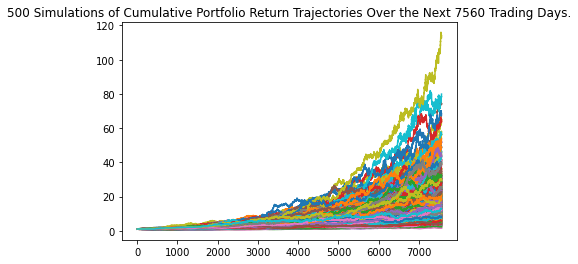

In [61]:
# Plot simulation outcomes
line_plot = MC_even_dist.plot_simulation()

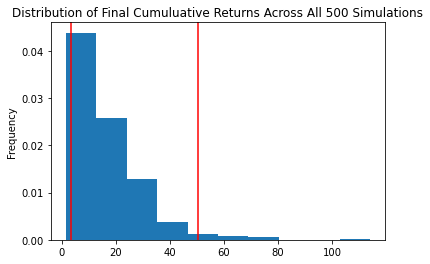

In [62]:
# Plot probability distribution and confidence intervals
dist_plot = MC_even_dist.plot_distribution()

### Retirement Analysis

In [63]:
# Fetch summary statistics from the Monte Carlo simulation results
even_tbl = MC_even_dist.summarize_cumulative_return()

# Print summary statistics
print(even_tbl)

count           500.000000
mean             16.872542
std              12.959685
min               1.486934
25%               8.359532
50%              12.952639
75%              21.988595
max             113.968761
95% CI Lower      3.390183
95% CI Upper     50.456367
Name: 7560, dtype: float64


### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [64]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
ci_lower = round(even_tbl[8]*initial_investment,2)
ci_upper = round(even_tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $67803.66 and $1009127.33


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [65]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
ci_lower = round(even_tbl[8]*initial_investment,2)
ci_upper = round(even_tbl[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $101705.49 and $1513691.0


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [66]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [67]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [68]:
# Plot simulation outcomes
# YOUR CODE HERE!

In [69]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [70]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

In [71]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

NameError: name 'ci_lower_five' is not defined

### Ten Years Retirement Option

In [30]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [31]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.997817,0.998428,1.000816,1.000202,1.002120,0.998788,1.004226,1.004250,1.001431,1.000740,...,0.995519,1.001253,1.000492,0.994026,1.006129,1.002356,1.005233,0.999769,1.002106,1.003746
2,0.994703,0.996223,1.001987,0.998816,1.002372,0.996708,1.009074,1.006986,1.006219,0.995591,...,0.991815,1.001091,1.003774,0.989341,1.007530,1.009809,1.007273,0.999666,1.006340,0.998303
3,0.994115,0.993375,0.992622,1.001069,0.999700,1.000123,1.011610,1.009254,1.012194,0.998619,...,0.992699,1.003085,1.005997,0.991536,1.004239,1.010765,1.009501,0.999652,1.011737,0.998762
4,0.999040,0.997821,0.992272,0.999767,1.000459,1.006178,1.008906,1.009897,1.014282,0.995619,...,0.997683,1.007825,1.007858,0.991188,1.009171,1.009303,1.008223,1.003270,1.014350,1.001691
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,2.164254,1.246948,1.441080,1.685210,1.702114,1.474774,1.535126,1.288182,1.138653,1.500977,...,1.367442,1.357662,1.661583,1.348599,1.649220,1.782632,1.450872,1.701338,1.199957,1.171159
2517,2.169555,1.246315,1.436260,1.685058,1.697652,1.479128,1.536203,1.288485,1.144082,1.498097,...,1.366833,1.360457,1.672969,1.351751,1.646287,1.781356,1.459438,1.695322,1.197466,1.171882
2518,2.169089,1.243387,1.426446,1.685480,1.714264,1.479079,1.537777,1.289258,1.140795,1.496271,...,1.368088,1.357853,1.662915,1.354957,1.637911,1.781046,1.451367,1.695901,1.201111,1.172847
2519,2.170695,1.238881,1.419187,1.670521,1.720418,1.478161,1.544292,1.296500,1.137510,1.499085,...,1.370125,1.359697,1.664317,1.352170,1.633762,1.778638,1.443413,1.699061,1.191529,1.166331


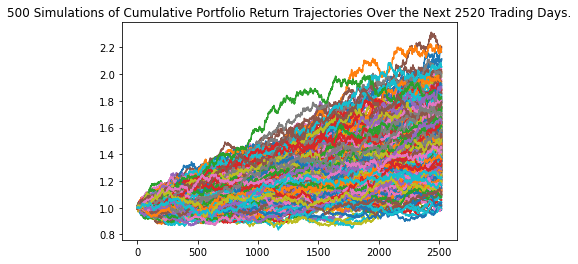

In [32]:
# Plot simulation outcomes
# YOUR CODE HERE!

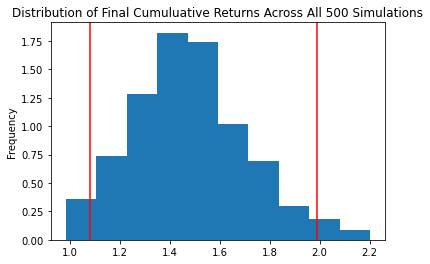

In [33]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [34]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

count           500.000000
mean              1.477364
std               0.230147
min               0.984413
25%               1.319127
50%               1.468676
75%               1.613270
max               2.202006
95% CI Lower      1.083048
95% CI Upper      1.990417
Name: 2520, dtype: float64


In [35]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 30 years will end within in the range of $64982.9 and $119425.0
